# Lokta-Volterra

In [14]:
using Pkg
Pkg.activate(".")
Pkg.develop(path="../")
Pkg.instantiate()

  Activating project at `~/PhD/MicroCanonicalHMC.jl/test`
   Resolving package versions...
  No Changes to `~/PhD/MicroCanonicalHMC.jl/test/Project.toml`
  No Changes to `~/PhD/MicroCanonicalHMC.jl/test/Manifest.toml`
Precompiling project...
  ✓ MicroCanonicalHMC
  1 dependency successfully precompiled in 5 seconds. 271 already precompiled.
  1 dependency precompiled but a different version is currently loaded. Restart julia to access the new version


In [15]:
using Turing
using DifferentialEquations
using LinearAlgebra
using PyPlot

# Set a seed for reproducibility.
using Random
Random.seed!(14)

using Revise
using MicroCanonicalHMC

# PDE-Modelling

In [16]:
# Define Lotka-Volterra model.
function lotka_volterra(du, u, p, t)
    # Model parameters.
    α, β, γ, δ = p
    # Current state.
    x, y = u

    # Evaluate differential equations.
    du[1] = (α - β * y) * x # prey
    du[2] = (δ * x - γ) * y # predator

    return nothing
end

# Define initial-value problem.
u0 = [1.0, 1.0]
p = [1.5, 1.0, 3.0, 1.0]
tspan = (0.0, 10.0)
prob = ODEProblem(lotka_volterra, u0, tspan, p);

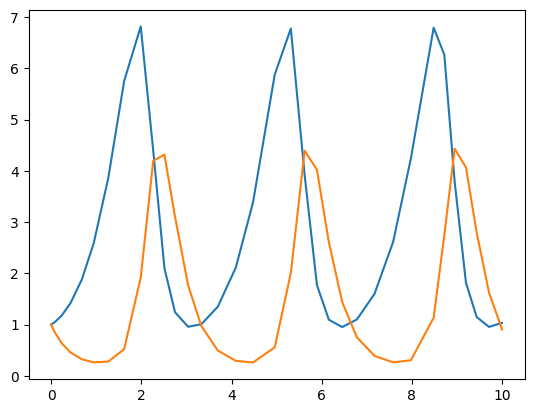

1-element Vector{PyCall.PyObject}:
 PyObject <matplotlib.lines.Line2D object at 0x7f8d7f583c10>

In [17]:
sol = solve(prob, Tsit5())
u_1 = [u[1] for u in sol.u]
u_2 = [u[2] for u in sol.u]
plt.plot(sol.t, u_1)
plt.plot(sol.t, u_2)

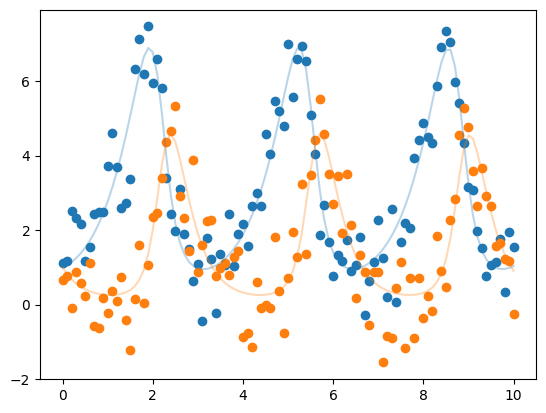

PyObject <matplotlib.collections.PathCollection object at 0x7f8d6d194c40>

In [18]:
sol = solve(prob, Tsit5(); saveat=0.1)
u_1 = [u[1] for u in sol.u]
u_2 = [u[2] for u in sol.u]
odedata = Array(sol) + 0.8 * randn(size(Array(sol)))
odedata[1, :]
# Plot simulation and noisy observations.
plt.plot(sol.t, u_1; alpha=0.3)
plt.plot(sol.t, u_2; alpha=0.3)
plt.scatter(sol.t, odedata[1, :]; label="")
plt.scatter(sol.t, odedata[2, :]; label="")

In [19]:
@model function fitlv(data, prob)
    # Prior distributions.
    σ ~ InverseGamma(2, 3)
    α ~ truncated(Normal(1.5, 0.5), 0.5, 2.5)
    β ~ truncated(Normal(1.2, 0.5), 0, 2)
    γ ~ truncated(Normal(3.0, 0.5), 1, 4)
    δ ~ truncated(Normal(1.0, 0.5), 0, 2)

    # Simulate Lotka-Volterra model. 
    p = [α, β, γ, δ]
    predicted = solve(prob, Tsit5(); p=p, saveat=0.1)

    # Observations.
    for i in 1:length(predicted)
        data[:, i] ~ MvNormal(predicted[i], σ^2 * I)
    end

    return nothing
end

model = fitlv(odedata, prob);

## MCHMC

In [20]:
target = TuringTarget(model);

In [21]:
spl = MCHMC(10_000, 0.01; sigma=ones(target.d), adaptive=true)
samples_mchmc = Sample(spl, target, 100_000; dialog=true);

[ Info: Tuning eps ⏳
[ Info: Tuning L ⏳
MCHMC (tuning):  16%|█████▊                             |  ETA: 0:00:05

Burn in step: 2000
eps --->0.018912130520084423


MCHMC (tuning):  20%|███████▏                           |  ETA: 0:00:06

L   --->0.004396686089108564
 


MCHMC (tuning):  38%|█████████████▍                     |  ETA: 0:00:03

Burn in step: 4000
eps --->0.018443676705602124
L   --->0.0032966847235008207
 


MCHMC (tuning):  60%|████████████████████▉              |  ETA: 0:00:02

Burn in step: 6000
eps --->0.021137216473397016
L   --->0.0032041733487003965
 


MCHMC (tuning):  79%|███████████████████████████▋       |  ETA: 0:00:01

Burn in step: 8000
eps --->0.017695370875519027
L   --->0.0024267639357866194
 


2mMCHMC (tuning): 100%|███████████████████████████████████| Time: 0:00:04

Burn in step: 10000
eps --->0.01701251384313562
L   --->0.002394936807128173
 


[ Info: eps: 0.01701251384313562
[ Info: L: 0.002394936807128173
[ Info: nu: 495.5414216117435
[ Info: sigma: [1.0, 1.0, 1.0, 1.0, 1.0]
[ Info: adaptive: true
2mMCHMC: 100%|████████████████████████████████████████████| Time: 0:00:29

In [22]:
σ_mchmc = [sample[1] for sample in samples_mchmc]
α_mchmc = [sample[2] for sample in samples_mchmc] 
β_mchmc = [sample[3] for sample in samples_mchmc]  
γ_mchmc = [sample[4] for sample in samples_mchmc]
δ_mchmc = [sample[5] for sample in samples_mchmc];

In [23]:
ESSs, rhat = Summarize(samples_mchmc)
ESS = mean(ESSs)
ESS

36680.50412448011

## NUTS

In [24]:
# Sample 3 independent chains with forward-mode automatic differentiation (the default).
samples_hmc = sample(model, NUTS(0.65), 5000; progress=true)

┌ Info: Found initial step size
└   ϵ = 0.0125
Sampling: 100%|█████████████████████████████████████████| Time: 0:00:46


Chains MCMC chain (5000×17×1 Array{Float64, 3}):

Iterations        = 1001:1:6000
Number of chains  = 1
Samples per chain = 5000
Wall duration     = 47.95 seconds
Compute duration  = 47.95 seconds
parameters        = σ, α, β, γ, δ
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse    ess_bulk    ess_tail      rhat   ⋯
      Symbol   Float64   Float64   Float64     Float64     Float64   Float64   ⋯

           σ    0.7783    0.0393    0.0008   2629.4483   2288.1899    1.0019   ⋯
           α    1.4719    0.0465    0.0013   1240.3874   1443.0397    1.0040   ⋯
           β    1.0021    0.0444    0.0011   1731.4125   2025.5988    0.9999   ⋯
           γ    3.1136    0.1451    0.0040   1303.5600   1497.8676    1.0037   ⋯
           δ    1.0405    0.0534    0.0015   1263.1072   1

In [25]:
σ_hmc = vec(samples_hmc["σ"])
α_hmc = vec(samples_hmc["α"])
β_hmc = vec(samples_hmc["β"]) 
γ_hmc = vec(samples_hmc["γ"])
δ_hmc = vec(samples_hmc["δ"]);

## Comp

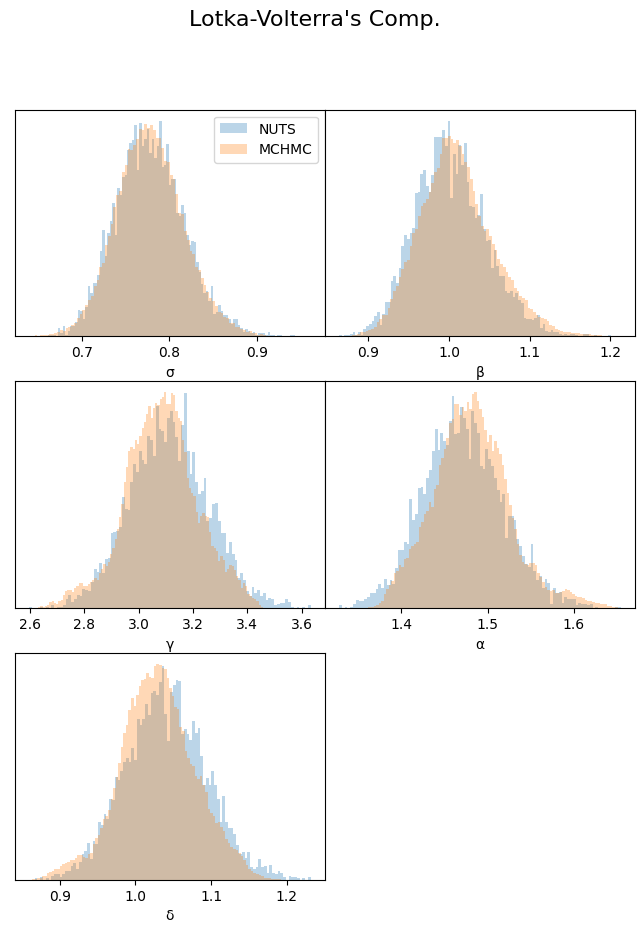

(0.0, 1.0, 0.0, 1.0)

In [26]:
fig, axis = plt.subplots(3, 2, figsize=(8,10))
fig.suptitle("Lotka-Volterra's Comp.", fontsize=16)

fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0)

axis[1,1].hist(σ_hmc, bins=100, density=true, alpha = 0.3, label="NUTS")
axis[1,1].hist(σ_mchmc, bins=100, density=true, alpha = 0.3, label="MCHMC")
axis[1,1].legend()
axis[1,1].set_xlabel("σ")
axis[1,1].set_yticks([])

axis[1,2].hist(β_hmc, bins=100, density=true, alpha = 0.3)
axis[1,2].hist(β_mchmc, bins=100, density=true, alpha = 0.3)
axis[1,2].set_xlabel("β")
axis[1,2].set_yticks([])

axis[2,1].hist(γ_hmc, bins=100, density=true, alpha = 0.3)
axis[2,1].hist(γ_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,1].set_xlabel("γ")
axis[2,1].set_yticks([])

axis[2,2].hist(α_hmc, bins=100, density=true, alpha = 0.3)
axis[2,2].hist(α_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,2].set_xlabel("α")
axis[2,2].set_yticks([])

axis[3,1].hist(δ_hmc, bins=100, density=true, alpha = 0.3)
axis[3,1].hist(δ_mchmc, bins=100, density=true, alpha = 0.3)
axis[3,1].set_xlabel("δ")
axis[3,1].set_yticks([])

axis[3,2].axis("off")

# SDE-Modelling

In [14]:
u0 = [1.0, 1.0]
tspan = (0.0, 10.0)
function multiplicative_noise!(du, u, p, t)
    x, y = u
    du[1] = p[5] * x
    return du[2] = p[6] * y
end
p = [1.5, 1.0, 3.0, 1.0, 0.1, 0.1]

function lotka_volterra!(du, u, p, t)
    x, y = u
    α, β, γ, δ = p
    du[1] = dx = α * x - β * x * y
    return du[2] = dy = δ * x * y - γ * y
end

prob_sde = SDEProblem(lotka_volterra!, multiplicative_noise!, u0, tspan, p)
# = EnsembleProblem(prob_sde)
#data = solve(ensembleprob, SOSRI(); saveat=0.1, trajectories=1000)
;

In [15]:
@model function fitlv_sde(data, prob)
    # Prior distributions.
    σ ~ InverseGamma(2, 3)
    α ~ truncated(Normal(1.3, 0.5), 0.5, 2.5)
    β ~ truncated(Normal(1.2, 0.25), 0.5, 2)
    γ ~ truncated(Normal(3.2, 0.25), 2.2, 4.0)
    δ ~ truncated(Normal(1.2, 0.25), 0.5, 2.0)
    ϕ1 ~ truncated(Normal(0.12, 0.3), 0.05, 0.25)
    ϕ2 ~ truncated(Normal(0.12, 0.3), 0.05, 0.25)

    # Simulate stochastic Lotka-Volterra model.
    p = [α, β, γ, δ, ϕ1, ϕ2]
    predicted = solve(prob, SOSRI(); p=p, saveat=0.1)

    # Early exit if simulation could not be computed successfully.
    if predicted.retcode !== :Success
        Turing.@addlogprob! -Inf
        return nothing
    end

    # Observations.
    for i in 1:length(predicted)
        data[:, i] ~ MvNormal(predicted[i], σ^2 * I)
    end

    return nothing
end;

In [16]:
model_sde = fitlv_sde(odedata, prob_sde);

## MCHMC

In [17]:
target = TuringTarget(model_sde);

In [18]:
spl = MCHMC(10_000, 0.0001; sigma=ones(target.d), adaptive=true)
samples_mchmc = Sample(spl, target, 100_000;
                       init_x=[1.5, 1.3, 1.2, 2.7, 1.2, 0.12, 0.12],
                       dialog=true);

[ Info: Tuning eps ⏳
[ Info: Tuning L ⏳
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiff

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC (tuning):  18%|██████▏                            |  ETA: 0:00:02┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC (tuning):  22%|███████▋                           |  ETA: 0:00:02┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

Burn in step: 2000
eps --->NaN
L   --->NaN
 


┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:   3%|█▎                                          |  ETA: 0:00:25┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  16%|███████▏                                    |  ETA: 0:00:19┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  17%|███████▍                                    |  ETA: 0:00:19┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  30%|█████████████▎                              |  ETA: 0:00:16┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  31%|█████████████▌                              |  ETA: 0:00:16┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  32%|█████████████▉                              |  ETA: 0:00:16┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

MCHMC:  43%|███████████████████                         |  ETA: 0:00:13┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  44%|███████████████████▌                        |  ETA: 0:00:13┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  46%|████████████████████▏                       |  ETA: 0:00:12┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  57%|█████████████████████████▏                  |  ETA: 0:00:10┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

MCHMC:  58%|█████████████████████████▍                  |  ETA: 0:00:10┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  58%|█████████████████████████▌                  |  ETA: 0:00:09┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  59%|█████████████████████████▊                  |  ETA: 0:00:09┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  73%|████████████████████████████████▏           |  ETA: 0:00:06┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  73%|████████████████████████████████▍           |  ETA: 0:00:06┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/Stocha

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  86%|█████████████████████████████████████▋      |  ETA: 0:00:03┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

MCHMC:  86%|█████████████████████████████████████▉      |  ETA: 0:00:03┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  87%|██████████████████████████████████████▏     |  ETA: 0:00:03┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
MCHMC:  87%|██████████████████████████████████████▎     |  ETA: 0:00:03┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/S

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/r

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call f

┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Instability detected. Aborting
└ @ SciMLBase ~/.julia/packages/SciMLBase/VdcHg/src/integrator_interface.jl:596
┌ Warning: First function call for f produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:32
┌ Warning: First function call for g produced NaNs. Exiting.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/initdt.jl:36
┌ Warning: Automatic dt set the starting dt as NaN, causing instability.
└ @ StochasticDiffEq ~/.julia/packages/StochasticDiffEq/rZj4R/src/solve.jl:644
┌ Warning: Ins

In [19]:
σ_mchmc = [sample[1] for sample in samples_mchmc]
α_mchmc = [sample[2] for sample in samples_mchmc] 
β_mchmc = [sample[3] for sample in samples_mchmc]  
γ_mchmc = [sample[4] for sample in samples_mchmc]
δ_mchmc = [sample[5] for sample in samples_mchmc]
ϕ1_mchmc = [sample[6] for sample in samples_mchmc]
ϕ2_mchmc = [sample[7] for sample in samples_mchmc];

In [20]:
ESSs, rhat = Summarize(samples_mchmc)
ESS = mean(ESSs)
ESS

201.07774619316223

## NUTS

In [21]:
# Sample 3 independent chains with forward-mode automatic differentiation (the default).
samples_hmc = sample(model_sde, NUTS(0.25), 5000; progress=true)

LoadError: InterruptException:

In [22]:
σ_hmc = vec(samples_hmc["σ"])
α_hmc = vec(samples_hmc["α"])
β_hmc = vec(samples_hmc["β"]) 
γ_hmc = vec(samples_hmc["γ"])
δ_hmc = vec(samples_hmc["δ"])
ϕ1_hmc = vec(samples_hmc["ϕ1"])
ϕ2_hmc = vec(samples_hmc["ϕ2"]);

LoadError: ArgumentError: index ϕ1 not found

## Comp

In [23]:
fig, axis = plt.subplots(4, 2, figsize=(8,12))
fig.suptitle("Lotka-Volterra's Comp.", fontsize=16)

fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0)

axis[1,1].hist(σ_hmc, bins=100, density=true, alpha = 0.3, label="NUTS")
axis[1,1].hist(σ_mchmc, bins=100, density=true, alpha = 0.3, label="MCHMC")
axis[1,1].legend()
axis[1,1].set_xlabel("σ")
axis[1,1].set_yticks([])

axis[1,2].hist(β_hmc, bins=100, density=true, alpha = 0.3)
axis[1,2].hist(β_mchmc, bins=100, density=true, alpha = 0.3)
axis[1,2].set_xlabel("β")
axis[1,2].set_yticks([])

axis[2,1].hist(γ_hmc, bins=100, density=true, alpha = 0.3)
axis[2,1].hist(γ_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,1].set_xlabel("γ")
axis[2,1].set_yticks([])

axis[2,2].hist(α_hmc, bins=100, density=true, alpha = 0.3)
axis[2,2].hist(α_mchmc, bins=100, density=true, alpha = 0.3)
axis[2,2].set_xlabel("α")
axis[2,2].set_yticks([])

axis[3,1].hist(δ_hmc, bins=100, density=true, alpha = 0.3)
axis[3,1].hist(δ_mchmc, bins=100, density=true, alpha = 0.3)
axis[3,1].set_xlabel("δ")
axis[3,1].set_yticks([])

axis[3,2].axis("off")

axis[4,1].hist(ϕ1_hmc, bins=100, density=true, alpha = 0.3)
axis[4,1].hist(ϕ1_mchmc, bins=100, density=true, alpha = 0.3)
axis[4,1].set_xlabel("γ")
axis[4,1].set_yticks([])

axis[4,2].hist(ϕ2_hmc, bins=100, density=true, alpha = 0.3)
axis[4,2].hist(ϕ2_mchmc, bins=100, density=true, alpha = 0.3)
axis[4,2].set_xlabel("α")
axis[4,2].set_yticks([])
;

LoadError: PyError ($(Expr(:escape, :(ccall(#= /home/jaimerz/.julia/packages/PyCall/twYvK/src/pyfncall.jl:43 =# @pysym(:PyObject_Call), PyPtr, (PyPtr, PyPtr, PyPtr), o, pyargsptr, kw))))) <class 'ValueError'>
ValueError('autodetected range of [nan, nan] is not finite')
  File "/home/jaimerz/.local/lib/python3.8/site-packages/matplotlib/__init__.py", line 1423, in inner
    return func(ax, *map(sanitize_sequence, args), **kwargs)
  File "/home/jaimerz/.local/lib/python3.8/site-packages/matplotlib/axes/_axes.py", line 6737, in hist
    m, bins = np.histogram(x[i], bins, weights=w[i], **hist_kwargs)
  File "<__array_function__ internals>", line 180, in histogram
  File "/home/jaimerz/.local/lib/python3.8/site-packages/numpy/lib/histograms.py", line 793, in histogram
    bin_edges, uniform_bins = _get_bin_edges(a, bins, range, weights)
  File "/home/jaimerz/.local/lib/python3.8/site-packages/numpy/lib/histograms.py", line 426, in _get_bin_edges
    first_edge, last_edge = _get_outer_edges(a, range)
  File "/home/jaimerz/.local/lib/python3.8/site-packages/numpy/lib/histograms.py", line 323, in _get_outer_edges
    raise ValueError(
